<h3 align="center" style="font-size:26px;">
  BÁO CÁO KẾT QUẢ ÁP DỤNG THUẬT TOÁN DEEP Q-NETWORK VÀ THUẬT TOÁN DOUBLE-DQN
</h3>



### Mô tả môi trường Lunar Lander-v3 : 

- Môi trường LunarLander-v3 là một môi trường mô phỏng của thư viện Gym do OpenAI phát triển, nhằm phục vụ cho các thuật toán học tăng cường (Reinforcement Learning) và cho thấy hiệu quả của các thuật toán học tăng cường bao gồm Q-learning, DQN, Double DQN, Dueling DQN, phương pháp policy gradient,.... 

- Nhiệm vụ : Điều khiển một tàu đổ bộ Mặt Trăng ( lunar lander ) hạ cánh an toàn giữa hai lá cờ trên bề mặt, hai chân chạm đất an toàn, không bị nổ hay vỡ khi tàu vũ trụ tiếp đất.  

- Môi trường LunarLander-v3 sử dụng một vector trạng thái liên tục 8 chiều để mô tả trạng thái hiện tại của tàu vũ trụ : 

    1. $ x $ : hoành độ của tàu ( khoảng cách ngang so với tâm điểm ).
    2. $ y $ : tung độ của tàu ( khoảng cách thẳng đứng từ mặt đất ).
    3. $ v_x $ : vận tốc theo phương ngang.
    4. $ v_y $ : vận tốc theo phương dọc.
    5. $ \theta $ : góc nghiêng của tàu so với phương thẳng đứng (đơn vị radian).
    6. $ v_\theta $ : vận tốc quay (tốc độ thay đổi góc nghiêng).
    7. Left leg contact : boolean ( 0 hoặc 1 ) : Nếu chân trái của tàu vũ trụ chạm đất. 
    8. Right leg contact : boolean ( 0 hoặc 1 ) : Nếu chân phải của tàu vũ trụ chạm đất. 

    Như vậy Observation Space (Không gian trạng thái) là một vector gồm 8 giá trị thực (kiểu Box(-∞, ∞, shape=(8,), dtype=np.float32)), đại diện cho các trạng thái hiện tại của tàu vũ trụ.  
- Môi trường LunarLander-v3 là một môi trường rời rạc với 4 hành động : 
  
    1. Không làm gì. 
    2. Bật động cơ chính. 
    3. Bật động cơ phải.
    4. Bật động cơ trái.

- Phần thưởng mà agent nhận được trong môi trường LunarLander-v3 khi thực hiện hành động : 
    1. Agent sẽ được thưởng trong khoảng 100 - 140 điểm nếu hạ cánh thành công. 
    2. Agent sẽ được thưởng khoảng 10 điểm nếu mỗi chân chạm đất thành công. 
    3. Agent sẽ bị phạt 100 điểm nếu tàu hạ cánh không thành công.
    4. Agent sẽ bị phạt 0,03 điểm mỗi bước thời gian, điều này giúp tiết kiệm nhiên liệu. 
    
    Sau quá trình train mô hình xong tổng phần thưởng mà agent nhận được lớn hơn 200 điểm thì tỷ lệ hạ cánh thành công của tàu vũ trụ là khá cao. 

## 1 - Thuật toán sử dụng để giải quyết bài toán : Deep Q - NetWork 

- Lý thuyết : Thuật toán DQN (Deep Q-Network) là thuật toán có sự kết hợp giữa thuật toán học tăng cường cổ điển ( Q-learning ) và mạng nơ ron học sâu ( Deep Neural Network). Nó rất hữu ích trong việc xử lý không gian trạng thái liên tục và không gian hành động rời rạc, rất phù hợp mới bài toán LunarLander-v3.  
  
- Mô hình toán học của thuật toán : 
     - Tại mỗi thời điểm t, agent sẽ thực hiện :  
       1. Quan sát trạng thái: $ s_t \in S $
       2. Chọn hành động: $ a_t \in A $
       3. Nhận phần thưởng: $ r_t $
       4. Chuyển sang trạng thái tiếp theo: $ s_{t+1} $ 
       5. Chính sách tối ưu: $ \pi(a \mid s) $

     - Hàm giá trị hành động tối ưu, kí hiệu là $ Q^*(s, a) $: là giá trị kỳ vọng tối đa của tổng phần thưởng của agent khi bắt đầu từ trạng thái s, chọn hành động a và theo chính sách tối ưu $ \pi $ : 
        - $ Q^*(s, a) = \mathbb{E} \left[ \sum_{t=0}^{\infty} \gamma^t r_t \mid s_0 = s, a_0 = a, \pi \right] $, Với $ \gamma \in [0, 1) $ là hệ số chiết khấu.

        - Hàm $ Q^*(s, a) $ để chọn hành động tối ưu theo công thức: $ a^* = \arg\max_a Q^*(s, a) $ 
     - Khi không gian trạng thái quá lớn hoặc liên tục ( như trong LunarLander-v3 ), ta không thể lưu trữ toàn bộ bảng Q-value giống như thuật toán Q-learning truyền thống được. Vì vậy, DQN sử dụng một mạng neural để xấp xỉ hàm Q :
        - $ Q(s, a; \theta) \approx Q^*(s, a) $ 
     - Hàm mất mát được dùng để đo mức độ sai lệch giữa giá trị Q hiện tại (do mạng dự đoán) và giá trị Q mục tiêu (target Q-value), nó chính là thứ điều hướng quá trình học của mạng neural. Hàm mất mát sai số càng nhỏ thì mạng học cách ước lượng chính xác hơn giá trị hành động tốt nhất, từ đó chọn hành động tối ưu nhất khi tương tác với môi trường. 
        - $ L(\theta) = \mathbb{E}_{(s,a,r,s') \sim D} \left[ \left( y - Q(s,a;\theta) \right)^2 \right] $. Trong đó:
            1. $ D $ là replay buffer : bộ nhớ chứa các trải nghiệm $ (s, a, r, s') $
            2. $ y $ là giá trị mục tiêu cho $ Q(s,a) $ được tính bằng công thức : $ y = r + \gamma \max_{a'} Q(s', a'; \theta^-) $
            3. $ \theta $ là trọng số của mạng chính 
            4. $ \theta^- $ là tham số của target network, là bản sao tạm thời của $ \theta $, chỉ được cập nhật theo target_update. 
            5. $ L(\theta) $ : Tính trung bình lỗi bình phương giữa Q-value dự đoán và Q-value mục tiêu, qua nhiều trải nghiệm được lấy ra từ replay buffer. 
 - Cách thuật toán DQN hoạt động :   
    - Khởi tạo Q-network $ Q(s, a; \theta) $
    - Khởi tạo target network $ Q(s, a; \theta^-) = Q(s, a; \theta) $
    - Khởi tạo replay buffer $ D $
    - For mỗi episode:
         1. Reset môi trường 
         2. For mỗi bước trong episode:
               - Chọn hành động $ a $ theo chiến lược $ \varepsilon $-greedy từ $ Q(s, a; \theta) $
               - Thực hiện hành động $ a $ và nhận điểm thưởng $ r $
               - Lưu trải nghiệm $ (s, a, r, s') $ vào bộ nhớ $ D $
               - Lấy một mini-batch ngẫu nhiên từ $ D $
               - Tính giá trị mục tiêu: $ y = r + \gamma \max_{a'} Q(s', a'; \theta^-) $
               - Cập nhật tham số $ \theta $ bằng cách tối thiểu hàm :  $ \left( y - Q(s, a; \theta) \right)^2 $
         - Cập nhật target network:  $ \theta^- \leftarrow \theta $ sau $C$ bước 
               
- Môi trường LunarLander-v3 có không gian trạng thái lớn và liên tục mà không gian hành động lại rời rạc. Chính vì vậy mà thuật toán DQN được coi là lựa chọn rất phù hợp cho bài toán này vì DQN sử dụng mạng neural để xấp xỉ hàm Q-value giúp giải quyết được hạn chế của Q-learning truyền thống vốn không thể xử lý không gian trạng thái liên tục. Hơn nữa, thuật toán DQN còn tích hợp các kỹ thuật như replay buffer và target network để tăng tính ổn định và tính hiệu quả trong quá trình huấn luyện giúp cho tàu vũ trụ hạ cánh thành công. 

### Version đầu tiên : 

In [1]:
import gymnasium as gym
import torch
import torch.nn as nn
import torch.optim as optim
import random
from collections import deque
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

In [2]:
episodes = 1000
max_steps = 1000
batch_size = 64
gamma = 0.99
learning_rate = 0.001
epsilon_start = 1.0
epsilon_end = 0.01
epsilon_decay = 0.995
target_update = 10
memory_size = 100000

In [3]:
model_save_path = "./best_dqn_3.pth"

environment_one = gym.make("LunarLander-v3", render_mode="rgb_array")
state_size = environment_one.observation_space.shape[0]
action_size = environment_one.action_space.n

In [4]:
class DQN(nn.Module):
    def __init__(self, state_size, action_size):
        super(DQN, self).__init__()
        self.layers = nn.Sequential(
            nn.Linear(state_size, 128),
            nn.ReLU(),
            nn.Linear(128, 128),
            nn.ReLU(),
            nn.Linear(128, action_size),
        )

    def forward(self, x):
        return self.layers(x) 
    
memory = deque(maxlen=memory_size)

policy_net = DQN(state_size, action_size)
target_net = DQN(state_size, action_size)
target_net.load_state_dict(policy_net.state_dict())

<All keys matched successfully>

In [5]:
def act(state, epsilon):
    if random.random() < epsilon:
        return random.randint(0, action_size - 1) 
    state_tensor = torch.FloatTensor(state).unsqueeze(0)
    with torch.no_grad():
        Q_values = policy_net(state_tensor)
    return torch.argmax(Q_values).item() 
    
optimizer = optim.Adam(policy_net.parameters(), lr=learning_rate)
criterion = nn.MSELoss() 

In [6]:
def replay():
    if len(memory) < batch_size:
        return 
    
    batch = random.sample(memory, batch_size)
    state, actions, rewards, next_state, done = zip(*batch)

    state = torch.FloatTensor(state)
    actions = torch.LongTensor(actions).unsqueeze(1)
    rewards = torch.FloatTensor(rewards).unsqueeze(1)
    next_state = torch.FloatTensor(next_state)
    done = torch.FloatTensor(done).unsqueeze(1)

    Q_values = policy_net(state).gather(1, actions)  
    next_Q_values = target_net(next_state).max(1)[0].detach().unsqueeze(1)
    targets = rewards + gamma * next_Q_values * (1 - done)  

    loss = criterion( Q_values, targets) 

    optimizer.zero_grad()
    loss.backward()
    optimizer.step()

In [ ]:
epsilon = epsilon_start 
best_reward = -float("inf") 
list_reward = []  

for i in range(1, episodes + 1):
    state, _ = environment_one.reset()
    total_reward = 0  
    for j in range(max_steps): 
        action = act(state, epsilon)  
        next_state, reward, done, truncated, _ = environment_one.step(action)  
        
        # Thưởng khi hạ cánh ở giữa : 
        x_pos = next_state[0]
        reward += (1 - abs(x_pos)) * 5  
        
        # Thưởng động cơ trái phải : 
        left_leg, right_leg = next_state[6], next_state[7]
        if left_leg > 0.1 or right_leg > 0.1: 
            reward += 10
           

        memory.append((state, action, reward, next_state, done)) 
        state = next_state
        total_reward += reward

        replay() 

        if done or truncated:  
            break
    epsilon = max(epsilon_end, epsilon * epsilon_decay)  
    list_reward.append(total_reward) 

    if i % target_update == 0:
        target_net.load_state_dict(policy_net.state_dict()) 

    if total_reward > best_reward:
        best_reward = total_reward
        torch.save(policy_net.state_dict(), model_save_path) 
        
environment_one.close() 

In [7]:
# Load môi trường và mô hình
environment_one = gym.make("LunarLander-v3", render_mode="rgb_array")

policy_net.load_state_dict(torch.load("best_dqn_3.pth")) 
policy_net.eval()

state, _ = environment_one.reset()
done = False
total_reward = 0
frames = []

while not done:
    state_tensor = torch.FloatTensor(state).unsqueeze(0)
    with torch.no_grad():
        action = policy_net(state_tensor).argmax().item()
    next_state, reward, terminated, truncated, _ = environment_one.step(action)
    done = terminated or truncated
    frames.append(environment_one.render())
    state = next_state
    total_reward += reward

environment_one.close()

# Tạo animation hiển thị trong notebook
fig, ax = plt.subplots()
fig.set_size_inches(6.4, 4.8) 
ax.axis('off')
img = ax.imshow(frames[0])

def update(frame):
    img.set_array(frame)
    return [img]

ani = animation.FuncAnimation(fig, update, frames=frames, interval=33, blit=True)
plt.close(fig) 

print(f"Tổng điểm thưởng mà agent nhận được là: {total_reward:.2f}")

HTML(ani.to_jshtml()) 

C:\Users\NGUYEN GIA KHANH\AppData\Local\Temp\ipykernel_19900\2683383000.py:4: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  policy_net.load_state_dict(torch.load("best_dqn_3

Tổng điểm thưởng mà agent nhận được là: 94.23


Ở version này, với việc cộng điểm thưởng cho agent khi hạ cánh ở giữa và thưởng cho agent khi 1 trong 2 chân chạm đất thì cơ bản biết được cách hạ cánh hai chân chạm đất tránh việc chân chạm mất bị gãy bị nổ do lực ma sát của môi trường, agent đã học được cách hạ cánh vào giữa hai lá cờ tuy nhiên vẫn còn chưa chính xác vào đúng giữa hai lá cờ, ngoài ra khi hạ cánh xuống đất, agent đang tiêu tốn quá nhiên liệu để giữ thăng bằng tránh bị trượt xuống. Như vậy ở version này, agent đã bắt đầu nhận thức được việc hạ cánh vào giữa hai lá cờ, không bị nổ khi tiếp đất. Cách giải quyết những vấn đề agent gặp phải : Tiếp tục train sử dụng nhiều cách cộng điểm thưởng cho agent khác nhau để tìm ra giải pháp tối ưu hơn. 

### Version thứ hai : 

In [ ]:
model_save_path = "./best_dqn_2.pth"   

In [ ]:
epsilon = epsilon_start 
best_reward = -float("inf") 
list_reward = []  

for i in range(1, episodes + 1):
    state, _ = environment_one.reset()
    total_reward = 0  
    for j in range(max_steps): 
        action = act(state, epsilon)  
        next_state, reward, done, truncated, _ = environment_one.step(action)  

        # Phạt nếu góc nghiêng quá lớn : 
        angle = next_state[4]
        reward -= abs(angle) * 5
        
        # Thưởng khi gần sát bệ đáp (x ≈ 0) : 
        x_pos = next_state[0]
        reward += (1 - abs(x_pos)) * 5  

        memory.append((state, action, reward, next_state, done)) 
        state = next_state
        total_reward += reward

        replay() 

        if done or truncated:  
            break
    epsilon = max(epsilon_end, epsilon * epsilon_decay)  
    list_reward.append(total_reward) 

    if i % target_update == 0:
        target_net.load_state_dict(policy_net.state_dict()) 

    if total_reward > best_reward:
        best_reward = total_reward
        torch.save(policy_net.state_dict(), model_save_path) 
        
environment_one.close() 

In [34]:
# Load môi trường và mô hình
environment = gym.make("LunarLander-v3", render_mode="rgb_array")

policy_net.load_state_dict(torch.load("best_dqn_2.pth"))
policy_net.eval()

state, _ = environment.reset()
done = False
total_reward = 0
frames = []

while not done:
    state_tensor = torch.FloatTensor(state).unsqueeze(0)
    with torch.no_grad():
        action = policy_net(state_tensor).argmax().item()
    next_state, reward, terminated, truncated, _ = environment.step(action)
    done = terminated or truncated
    frames.append(environment.render())
    state = next_state
    total_reward += reward

environment.close()

# Tạo animation hiển thị trong notebook
fig, ax = plt.subplots()
fig.set_size_inches(6.4, 4.8) 
ax.axis('off')
img = ax.imshow(frames[0])

def update(frame):
    img.set_array(frame)
    return [img]

ani = animation.FuncAnimation(fig, update, frames=frames, interval=33, blit=True)
plt.close(fig)  # Không hiển thị ảnh tĩnh

print(f"Tổng điểm thưởng mà agent nhận được là: {total_reward:.2f}")

HTML(ani.to_jshtml())

C:\Users\NGUYEN GIA KHANH\AppData\Local\Temp\ipykernel_26008\2991417863.py:4: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  policy_net.load_state_dict(torch.load("best_dqn_2

Tổng điểm thưởng mà agent nhận được là: 19.65


Ở version thứ hai, đã có cách cải tiến hơn so với version trước đó là việc thưởng thêm cho agent nếu hạ cánh đúng giữa hai là cờ và phạt agent nếu góc nghiêng ( góc giữa trục thân tàu và phương thẳng đứng hướng lên trên) nhằm mục đích giúp cho agent giữ thẳng đứng trong quá trình hạ cánh. Kết quả thu được góc nghiêng của tàu vũ trụ được cải thiện tương đối và hạ cánh được vào hai lá cờ tuy nhiên agent sử động cơ chính và phụ quá nhiều dẫn đến việc tốn quá nhiều nhiên liệu để hạ cánh xuống mặt đất điều này cần được cải thiện. Cách giải quyết tiếp tục train và cố gắng tìm ra cách tối ưu cho agent hạ cách vào giữa hai lá cờ tiết kiệm nhiên liệu nhất. 

### Version thứ ba : 

In [ ]:
model_save_path = "./best_dqn_1.pth"     

In [ ]:
epsilon = epsilon_start 
best_reward = -float("inf") 
list_reward = []  

for i in range(1, episodes + 1):
    state, _ = environment_one.reset()
    total_reward = 0  
    for j in range(max_steps): 
        action = act(state, epsilon)  
        next_state, reward, done, truncated, _ = environment_one.step(action)  
        
        # Thưởng khi hạ cánh ở giữa : 
        x_pos = next_state[0]
        reward += (1 - abs(x_pos)) * 5  

        memory.append((state, action, reward, next_state, done)) 
        state = next_state
        total_reward += reward

        replay() 

        if done or truncated:  
            break
    epsilon = max(epsilon_end, epsilon * epsilon_decay)  
    list_reward.append(total_reward) 

    if i % target_update == 0:
        target_net.load_state_dict(policy_net.state_dict()) 

    if total_reward > best_reward:
        best_reward = total_reward
        torch.save(policy_net.state_dict(), model_save_path) 
        
environment_one.close() 


In [37]:
# Load môi trường và mô hình
environment_one = gym.make("LunarLander-v3", render_mode="rgb_array")

policy_net.load_state_dict(torch.load("best_dqn_1.pth")) 
policy_net.eval()

state, _ = environment_one.reset()
done = False
total_reward = 0
frames = []

while not done:
    state_tensor = torch.FloatTensor(state).unsqueeze(0)
    with torch.no_grad():
        action = policy_net(state_tensor).argmax().item()
    next_state, reward, terminated, truncated, _ = environment_one.step(action)
    done = terminated or truncated
    frames.append(environment_one.render())
    state = next_state
    total_reward += reward

environment_one.close()

# Tạo animation hiển thị trong notebook
fig, ax = plt.subplots()
fig.set_size_inches(6.4, 4.8) 
ax.axis('off')
img = ax.imshow(frames[0])

def update(frame):
    img.set_array(frame)
    return [img]

ani = animation.FuncAnimation(fig, update, frames=frames, interval=33, blit=True)
plt.close(fig) 

print(f"Tổng điểm thưởng mà agent nhận được là: {total_reward:.2f}")

HTML(ani.to_jshtml())

C:\Users\NGUYEN GIA KHANH\AppData\Local\Temp\ipykernel_26008\4001318378.py:4: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  policy_net.load_state_dict(torch.load("best_dqn_1

Tổng điểm thưởng mà agent nhận được là: 208.12


Version tiếp theo, với việc chỉ cộng điểm thưởng cho agent nếu hạ cánh đúng vị trí chính giữa hai lá cờ (x_pos ≈ 0) thấy được rằng agent đã học được cách hạ cánh thành công tốt hơn rất nhiêu so với hai version ở trên agent đã hạ cánh an toàn không bị nổ hãy vỡ đây được coi là cải tiến rất lớn so với 2 version trước đó, tuy nhiên agent có khuyết điểm agent tốn rất nhiều nhiên liệu cho quá trình hạ cánh của mình ở lá cờ bên trái và khi tiếp đất cũng mất nhiều thời gian và nhiên liệu thì mới thành công. Đề xuất tối ưu tiếp bằng cách thưởng mạnh hơn nữa nếu agent thực hiện hạ cánh đúng giữa hai lá cờ và phạt mạnh nếu ngược lại với mục đích làm cho agent hạ cánh thành công sao cho nó tiết kiệm nhiên liệu được ít nhất. 


Ở version tiếp theo, đã tiến hành phạt mạnh nếu tàu lệch hỏi vị trí trung tâm và cho agent thực hiện 1000 bước rồi kết thúc ( Nếu không giới hạn số bước, agent có thể bay lơ lửng không hạ cánh hoặc di chuyển mãi không kết thúc tập gẫy lãng phí , tốn nhiên liêu,..), điều này giúp cho agent hạ cánh thành công vào đúng giữa hai lá cờ, tiết kiệm nhiều nhiên liệu, đạt tỉ lệ hạ cánh thành công rất cao. Nội dung chi tiết có trong version tối ưu nhất dưới đây. 


###  Version tối ưu nhất : 

#### Khai báo các thư viện cần dùng : 

In [1]:
import gymnasium as gym
import torch
import torch.nn as nn
import torch.optim as optim
import random
from collections import deque
import matplotlib.pyplot as plt
from tqdm import trange
import matplotlib.animation as animation
from IPython.display import HTML

#### Thiết bị sử dụng để train mô hình : 

- Tốc độ xử lý tính toán, thời gian huấn luyện model của GPU nhanh hơn rất nhiều so với CPU. Vì vậy, em sử dụng GPU để train model, cell ở dưới mô tả thiết bị dùng để tiến hành việc huấn luyện mô hình. 

In [2]:
if torch.cuda.is_available():
    device = torch.device("cuda")
    device_name = torch.cuda.get_device_name(device)
    print(f"Sử dụng thiết bị để train model : {device_name} ")
else:
    print(f"Sử dụng CPU để train model")

Sử dụng thiết bị để train model : NVIDIA GeForce RTX 3050 Laptop GPU 


#### Khởi tạo các siêu tham số : 

In [3]:
episodes = 3000  # Số tập huấn luyện của agent.
max_steps = 1000  # Số bước agent thực hiện ở mỗi tập.
batch_size = 64  # Số mẫu lấy ra từ replay buffer mỗi lần huấn luyện.
gamma = 0.99  # Hệ số chiết khấu.
learning_rate = 0.001  # Tốc độ học của mạng.
epsilon_start = 1.0  # Xác suất chọn hành động ngẫu nhiên của agent.
epsilon_end = 0.01  # Giá trị tối thiểu của epsilon.
epsilon_decay = 0.997  # Tốc độ giảm epsilon sau mỗi tập.
# Sau mỗi 10 tập huấn luyện, các trọng số của target network sẽ được cập nhật.
target_update = 10
memory_size = 100000  # Kích thước tối đa của replay buffer.
model_save_path = "./best_dqn_main.pth"  # Đường dẫn lưu model tốt nhất.

#### Khởi tạo môi trường : 

In [4]:
environment = gym.make("LunarLander-v3", render_mode="rgb_array")
state_size = environment.observation_space.shape[0]
action_size = environment.action_space.n

#### Class DQN : 

- Lớp DQN là một mạng neural dùng trong học tăng cường để ước lượng Q-value cho từng hành động, từ một trạng thái đầu vào. Nó gồm 3 lớp Linear với ReLU, đầu ra là vector Q-values cho tất cả các hành động. 

- Hàm forward(x) nhận đầu vào là một trạng thái là 1 vector có kích thước state_size, biểu diễn thông tin hiện tại của môi trường và trả về một vector có độ dài bằng action_size, đại diện cho các giá trị Q-value của từng hành động của agent thực hiện trong môi trường.  

In [5]:
class DQN(nn.Module):
    def __init__(self, state_size, action_size):
        super(DQN, self).__init__()
        self.layers = nn.Sequential(
            nn.Linear(state_size, 256),
            nn.ReLU(),
            nn.Linear(256, 256),
            nn.ReLU(),
            nn.Linear(256, action_size),
        )

    def forward(self, x):
        return self.layers(x)

#### Replay Buffer : 
Câu lệnh tạo một bộ nhớ kinh nghiệm (replay buffer) dùng để lưu trữ các trải nghiệm (s, a, r, s', done) - bộ 5 giá trị: trạng thái, hành động, phần thưởng, trạng thái tiếp theo, đã kết thúc chưa : 
 - deque : là một hàng đợi hai đầu, cho phép thêm hoặc xóa phần tử ở hai đầu.  
 - maxlen = memory_size : giới hạn kích thước bộ nhớ. Khi đầy, phần tử cũ nhất sẽ tự động bị loại bỏ để nhường chỗ cho phần mới.

In [6]:
memory = deque(maxlen=memory_size)

#### Khởi tạo mạng : 

+, Tạo mạng chính (policy_net) để chọn hành động trong quá trình huấn luyện.
   - Mạng này học và được cập nhật liên tục qua gradient descent

+, Tạo mạng mục tiêu (target_net) – một bản sao tạm thời và ổn định của policy_net.
   - Dùng để tính target Q-value trong quá trình huấn luyện (giúp tránh mạng học từ chính các giá trị nó vừa dự đoán → ổn định hơn).
  
+, load_state_dict: Sao chép toàn bộ trọng số từ policy_net sang target_net theo target_update 

In [7]:
policy_net = DQN(state_size, action_size).to(device)
target_net = DQN(state_size, action_size).to(device)
target_net.load_state_dict(policy_net.state_dict())

<All keys matched successfully>

#### Chiến lược epsilon-greedy:

- Với xác suất epsilon, chọn hành động ngẫu nhiên.
- Với xác suất 1 - epsilon chọn hành động có giá trị Q cao nhất theo mạng policy_net hiện tại.

Hàm action (state, epsilon) có mục đích chọn hành động trong môi trường Reinforcement Learning tuân theo chiến lược epsilon-greedy, state là trạng thái hiện tại của môi trường, epsilon là tham số xác suất để chọn hành động ngẫu nhiên. 

In [8]:
def act(state, epsilon):
    if random.random() < epsilon:
        # Tạo ra 1 số ngẫu nhiên nhỏ hơn epsilon => chọn hành động ngẫu nhiên trong không gian hành động.
        return random.randint(0, action_size - 1)
    state_tensor = torch.FloatTensor(state).unsqueeze(0).to(device)
    with torch.no_grad():
        Q_values = policy_net(state_tensor)  # Dự đoán Q-values từ policy_net
    # Trả về hành động có Q-value lớn nhất <=> Chọn hành động tốt nhất theo mạng
    return torch.argmax(Q_values).item()

In [9]:
# Điều chỉnh trọng số mạng để giảm lỗi ( dùng thuật toán tối ưu Adam)
optimizer = optim.Adam(policy_net.parameters(), lr=learning_rate)
# Tính toán sai số giữa Q-value dự đoán và giá trị mục tiêu (dùng MSELoss())
criterion = nn.MSELoss()

#### Hàm replay () : 

- Hàm replay() thực hiện lấy mẫu từ bộ nhớ, tính giá trị mục tiêu 𝑦 so sánh với Q-value hiện tại, tính hàm mất mát và cập nhật trọng số mạng chính bằng thuật toán lan truyền ngược để giúp cho mạng neural để dự đoán chính xác hơn Q-value, từ đó giúp agent ra quyết định hành động tối ưu trong từng trạng thái. 

In [22]:
def replay():
    #  Nếu số lượng mẫu trong bộ nhớ chưa đủ để tạo một batch, bỏ qua quá trình huấn luyện.
    if len(memory) < batch_size:
        return
    # Lấy ngẫu nhiên một nhóm trải nghiệm từ bộ nhớ, rồi tách riêng từng phần :
    batch = random.sample(memory, batch_size)
    state, actions, rewards, next_state, done = zip(*batch)

    # Chuyển dữ liệu sang tensor và đưa lên thiết bị GPU cho việc tính toán :
    state = torch.FloatTensor(state).to(device)
    actions = torch.LongTensor(actions).unsqueeze(1).to(device)
    rewards = torch.FloatTensor(rewards).unsqueeze(1).to(device)
    next_state = torch.FloatTensor(next_state).to(device)
    done = torch.FloatTensor(done).unsqueeze(1).to(device)

    # Dự đoán Q-value của các hành động tại mỗi state bằng mạng chính (policy_net)
    Q_values = policy_net(state).gather(1, actions)
    # mạng mục tiêu tính Q-values cho tất cả hành động tại trạng thái tiếp theo, sau đó chọn Q-value lớn nhất, không lan truyền gradient về target_net vì mạng này chỉ dùng để tính giá trị mục tiêu, không để huấn luyện.
    next_Q_values = target_net(next_state).max(1)[0].detach().unsqueeze(1)
    # Tính giá trị mục tiêu.
    targets = rewards + gamma * next_Q_values * (1 - done)

    # Tính loss giữa giá trị Q-value hiện tại và giá trị mục tiêu.
    loss = criterion(Q_values, targets)

    # Tính gradient descent và cập nhật trọng số của mạng để giảm loss.
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()

#### Hàm huấn luyện : 

Huấn luyện agent để tối đa hóa phần thưởng trong môi trường LunarLander-v3 giúp cho tàu vũ trụ hạ cánh thành công bằng cách :

- Tương tác với môi trường qua nhiều vòng lặp (episode)

- Lưu lại trải nghiệm vào bộ nhớ

- Học từ trải nghiệm bằng hàm replay()

- Cập nhật dần epsilon để giúp cho agent giảm dần tính ngẫu nhiên  

- Cập nhật mạng mục tiêu định kỳ 

- Lưu lại model tốt nhất để sử dụng. 

In [ ]:
epsilon = epsilon_start  # Agent chọn hành động ngẫu nhiên.
best_reward = -float("inf")  # Lưu phần thưởng tốt nhất.
list_reward = []  # Lưu danh sách phần thưởng mà agent nhận được.
for i in range(1, episodes + 1):
    # Đặt lại môi trường để bắt đầu lượt chơi mới của agent.
    state, _ = environment.reset()
    # Reset lại tổng phần thưởng ở lượt chơi cũ để bắt đầu lượt chơi mới.
    total_reward = 0
    for j in range(max_steps):  # Giới hạn số bước agent thực hiện
        # Agent chọn hành động từ trạng thái hiện tại, theo chính sách epsilon-greedy.
        action = act(state, epsilon)
        next_state, reward, done, truncated, _ = environment.step(action)  # Thực hiện hành động

        # Phạt tàu nếu lệch khỏi trung tâm, giúp agent học cách điều khiển tốt hơn để giữ thăng bằng và hạ cánh chính xác vào giữa 2 lá cờ.
        reward += -10 * abs(state[0])

        # Lưu trải nghiệm vào bộ nhớ .
        memory.append((state, action, reward, next_state, done))
        state = next_state
        total_reward += reward

        replay() 
     
        if done or truncated:  # Nếu kết thúc sớm (rơi hoặc hạ cánh) thì break.
            break
    # giảm dần khả năng chọn hành động ngẫu nhiên của agent.
    epsilon = max(epsilon_end, epsilon * epsilon_decay)
    # Lưu danh sách tổng phần thưởng agent nhận được.
    list_reward.append(total_reward)


    if i % target_update == 0:
        # cập nhật target_net để học ổn định hơn.
        target_net.load_state_dict(policy_net.state_dict())

    if total_reward > best_reward:
        best_reward = total_reward
        # Lưu model tốt nhất cho bài toán.
        torch.save(policy_net.state_dict(), model_save_path)

environment.close()

C:\Users\NGUYEN GIA KHANH\AppData\Local\Temp\ipykernel_14704\1438310602.py:10: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at C:\actions-runner\_work\pytorch\pytorch\builder\windows\pytorch\torch\csrc\utils\tensor_new.cpp:281.)
  state = torch.FloatTensor(state).to(device)


In [12]:
print(max(list_reward))

277.13858410825657


#### Biểu đồ hàm điểm thưởng của agent trên trung bình 100 tập huấn luyện : 

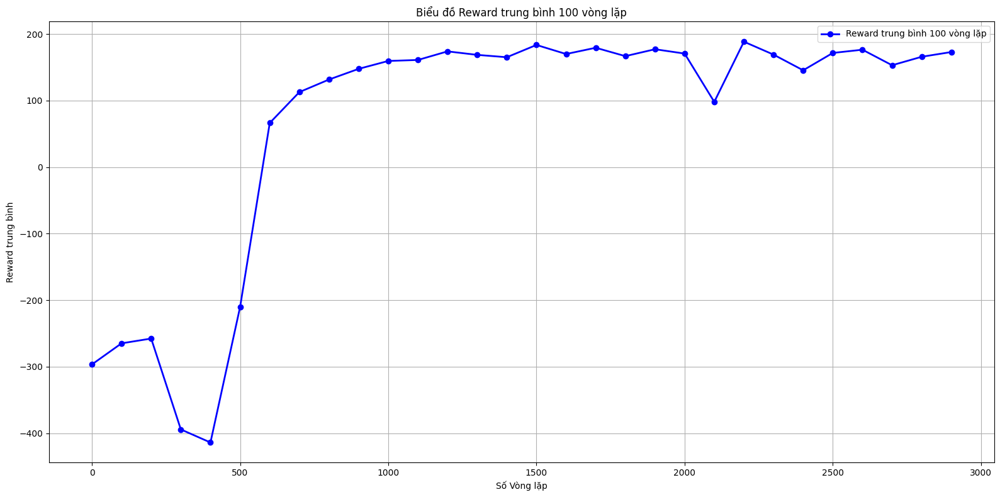

In [ ]:
average_reward = [sum(list_reward[i : i + 100]) / len(list_reward[i : i + 100]) for i in range(0, len(list_reward), 100)]

plt.figure(figsize=(16, 8))
plt.plot(
    range(0, len(list_reward), 100), 
    average_reward, 
    label="Reward trung bình 100 vòng lặp", 
    marker='o', 
    color='#0000FF', 
    linewidth=2
)
plt.xlabel("Số Vòng lặp")
plt.ylabel("Reward trung bình")
plt.title("Biểu đồ Reward trung bình 100 vòng lặp")
plt.legend(loc='upper left') 
plt.grid(True)
plt.tight_layout()
plt.legend()
plt.show()


Đồ thi mô tả chi tiết điểm thưởng trung bình của agent trên 100 tập huấn luyện, kết quả cho thấy hơn 500 tập đầu tiên agent chưa thông minh, đang trong quá trình khám phá môi trường nên tổng điểm thưởng trung bình mà agent nhận được là rất thấp . Tuy nhiên sau đó nhờ quá trình huấn luyện agent đã học hỏi khám phá được nhiều hơn từ đó giúp cho agent trở nên thông minh hơn, hiểu được cách đi tối ưu cách để hạ cánh đúng như những gì mong đợi là hạ cánh vào đúng giữa hai lá cờ, tiết kiệm được nhiên liệu nên các tập huấn luyện tiếp theo điểm thưởng trung bình agent tăng rất mạnh và nhiều lần đạt được số điểm thưởng cao, ( điểm thưởng cao nhất agent đạt được là hơn 277 ) để giúp cho nó hạ cánh với tỉ lệ thành công cao. Video dưới đây mô tả chi tiết điều đó. 

#### Hàm tạo video sau khi huấn luyện agent xong : 

In [39]:
# Load môi trường và mô hình
environment = gym.make("LunarLander-v3", render_mode="rgb_array")

policy_net.load_state_dict(torch.load(
    "best_dqn_main.pth", map_location=device))
policy_net.to(device)
policy_net.eval()

state, _ = environment.reset()
done = False
total_reward = 0
frames = []

while not done:
    state_tensor = torch.FloatTensor(state).unsqueeze(0).to(device)
    with torch.no_grad():
        action = policy_net(state_tensor).argmax().item()
    next_state, reward, terminated, truncated, _ = environment.step(action)
    done = terminated or truncated
    frames.append(environment.render())
    state = next_state
    total_reward += reward

environment.close()

# Tạo animation hiển thị trong notebook
fig, ax = plt.subplots()
fig.set_size_inches(6.4, 4.8)
ax.axis('off')
img = ax.imshow(frames[0])


def update(frame):
    img.set_array(frame)
    return [img]


ani = animation.FuncAnimation(
    fig, update, frames=frames, interval=33, blit=True)
plt.close(fig)  # Không hiển thị ảnh tĩnh

print(f"Tổng điểm thưởng mà agent nhận được là: {total_reward:.2f}")

HTML(ani.to_jshtml())

C:\Users\NGUYEN GIA KHANH\AppData\Local\Temp\ipykernel_7348\3809009435.py:4: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  policy_net.load_state_dict(torch.load(


Tổng điểm thưởng mà agent nhận được là: 274.66


#### Hàm đánh giá tỷ lệ hạ cánh thành công của agent : 

In [ ]:
# Load môi trường và model : 
environment = gym.make("LunarLander-v3", render_mode="rgb_array")

policy_net.to(device)  # Đưa mô hình lên đúng thiết bị
policy_net.load_state_dict(torch.load("best_dqn_main.pth", map_location=device))
policy_net.eval()

# Số liệu kiểm tra tỉ lệ hạ cánh thành công của agent :
reward_success = 200 # Điểm thưởng tối thiểu agent nhận được để hạ cánh thành công : 
count = 0 # Đếm số lần điểm thưởng > 200 

# Thử nghiệm việc agent hạ cánh thành công trên 1000 lần test : 
for i in trange(1000):
    state, _ = environment.reset()
    done = False
    total_reward = 0

    while not done:
        with torch.no_grad():
            state_tensor = torch.FloatTensor(state).unsqueeze(0).to(device)
            action = policy_net(state_tensor).argmax().item()

        next_state, reward, done, truncated, _ = environment.step(action)
        state = next_state
        total_reward += reward
        if truncated:
            break

    if total_reward >= reward_success:
        count += 1

environment.close()

# Tính toán tỷ lệ hạ cánh thành công của tàu vũ trụ :
success_rate = count / 1000 * 100
print(f"Tỷ lệ thành công: {success_rate:.2f}%") 


C:\Users\NGUYEN GIA KHANH\AppData\Local\Temp\ipykernel_19900\1140666864.py:5: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  policy_net.load_state_dict(torch.load("best_dqn_m

Tỷ lệ thành công: 95.60%


Để đảm bảo model hoạt động tốt đạt chất lượng tốt thì em đã tiến hành thử nghiệm , test lại nó trên 1000 tập huấn luyện để biết được độ chính xác của model. Với mốc điểm thưởng tối thiểu agent đạt được là 200 thì tỉ lệ hạ cánh thành công của tàu vũ trụ lên tới 95.6% cho thấy được hiệu quả của model. Tuy nhiên, do đây chỉ là một môi trường mô phỏng, nên khi triển khai trong thực tế, các yếu tố như nhiễu loạn môi trường, cảm biến sai số hoặc điều kiện vật lý phức tạp có thể ảnh hưởng đáng kể đến hiệu năng. Do đó, để tăng độ tin cậy em đề xuất xử lý bài toán LunarLander-v3 với thuật toán Double-DQN - thuật toán với phiên bản cải tiến hơn của DQN, áp dụng thuật toán này cho thấy tỉ lệ hạ cánh thành công ở mức rất cao, nội dung chi tiết hơn ở mục 2 dưới đây. 

#### Hàm đánh giá hiệu suất sử dụng động cơ, nhiên liệu của agent : 

In [ ]:
from collections import Counter

env = gym.make("LunarLander-v3")
state_size = env.observation_space.shape[0]
action_size = env.action_space.n

policy_net = DQN(state_size, action_size)
policy_net.load_state_dict(torch.load("best_dqn_main.pth"))
policy_net.eval()

n_episodes = 1000
engine_usage = Counter()
rewards = []

for _ in range(n_episodes):
    state, _ = env.reset()
    done = False
    total_reward = 0

    while not done:
        with torch.no_grad():
            state_tensor = torch.FloatTensor(state).unsqueeze(0)
            action = policy_net(state_tensor).argmax().item()

        engine_usage[action] += 1  # Ghi nhận hành động
        next_state, reward, done, truncated, _ = env.step(action)
        state = next_state
        total_reward += reward
        if truncated:
            break

    rewards.append(total_reward)

env.close()

# Tính toán hiệu suất sử dụng nhiên liệu
total_actions = sum(engine_usage.values())
no_engine_pct = engine_usage[0] / total_actions * 100
main_engine_pct = engine_usage[1] / total_actions * 100
side_engine_pct = (engine_usage[2] + engine_usage[3]) / total_actions * 100

print("Hiệu suất sử dụng nhiên liệu động cơ của agent : ")
print(f"Số hành động mà agent đã sử dụng : {total_actions}")

print(f"Tỷ lệ agent không sử dụng động cơ (%) : {engine_usage[0]} ({no_engine_pct:.2f}%)")
print(f"Tỷ lệ agent sử dụng động cơ chính (%) :  {engine_usage[1]} ({main_engine_pct:.2f}%)")
print(f"Tỷ lệ agent sử dụng động cơ phụ (%) : {engine_usage[2] + engine_usage[3]} ({side_engine_pct:.2f}%)")

C:\Users\NGUYEN GIA KHANH\AppData\Local\Temp\ipykernel_24040\561573321.py:8: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  policy_net.load_state_dict(torch.load("best_dqn_ma

Hiệu suất sử dụng nhiên liệu động cơ của agent : 
Số hành động mà agent đã sử dụng : 181917
Tỷ lệ agent không sử dụng động cơ (%) : 45279 (24.89%)
Tỷ lệ agent sử dụng động cơ chính (%) :  29456 (16.19%)
Tỷ lệ agent sử dụng động cơ phụ (%) : 107182 (58.92%)


Agent đã sử dụng động cơ phụ với tỉ lệ khá cao với gần 59%, điều này cho thấy agent thường xuyên cần điều chỉnh vị trí theo phương ngang hoặc giữ thăng bằng để ổn định tàu trong quá trình hạ cánh vì động cơ phụ thường được dùng để kiểm soát góc nghiêng và điều chỉnh hướng khi tiếp cận mặt đất. Tỉ lệ agent không sử dụng động cơ là khoảng gần 25% điều này thể hiện agent có những khoảng thời gian để tàu rơi tự do, tức đã học được cách tận dụng trọng lực thay vì tiêu hao nhiên liệu liên tục. Tỷ lệ dùng động cơ chính tương đối thấp khoảng hơn 16%, động cơ chính dùng để giảm tốc theo trục Y ( hãm rơi ), agent chỉ kích hoạt ngắn gọn, đúng lúc để giảm tốc lúc hạ cánh tránh va chạm mạnh khi tiếp xúc với mặt đất. 

#### Chỉnh hệ số learning_rate, discount factor và reward so với ban đầu : 

In [26]:
episodes = 800
max_steps = 1000
batch_size = 64
gamma = 0.999
learning_rate = 1e-4
epsilon_start = 1.0
epsilon_end = 0.01
# Chỉnh tăng thêm chút so với ban đầu ( ban đầu là 0.995)
epsilon_decay = 0.997
target_update = 10
memory_size = 100000
model_save_path_1 = "./best_model_adamw_smoothl1.pth"

In [ ]:
optimizer = optim.AdamW(policy_net.parameters(), lr=learning_rate) # Thay đổi thật toán tối ưu ( optim )
criterion = nn.SmoothL1Loss() # Thay đổi hàm mất mát 

In [ ]:
def replay():
    if len(memory) < batch_size:
        return
    batch = random.sample(memory, batch_size)
    state, actions, rewards, next_state, done = zip(*batch)

    state = torch.FloatTensor(state).to(device)
    actions = torch.LongTensor(actions).unsqueeze(1).to(device)
    rewards = torch.FloatTensor(rewards).unsqueeze(1).to(device)
    next_state = torch.FloatTensor(next_state).to(device)
    done = torch.FloatTensor(done).unsqueeze(1).to(device)

    Q_values = policy_net(state).gather(1, actions)
    next_Q_values = target_net(next_state).max(1)[0].detach().unsqueeze(1)
    targets = rewards + gamma * next_Q_values * (1 - done)

    loss = criterion(Q_values, targets)
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()


In [ ]:
epsilon = epsilon_start
best_reward = -float("inf")
list_reward = []

for i in range(1, episodes + 1):
    state, _ = environment.reset()
    total_reward = 0
    for j in range(max_steps):
        action = act(state, epsilon)
        action = int(action)
        next_state, reward, done, truncated, _ = environment.step(action)

        reward += -10 * abs(state[0])
        reward += -5 * abs(state[2]) # Giảm góc nghiêng cho agent. 
        memory.append((state, action, reward, next_state, done))
        state = next_state
        total_reward += reward
        replay()

        if done or truncated:
            break
    epsilon = max(epsilon_end, epsilon * epsilon_decay)
    list_reward.append(total_reward)
    if i % target_update == 0:
        target_net.load_state_dict(policy_net.state_dict())
    if total_reward > best_reward:
        best_reward = total_reward
        torch.save(policy_net.state_dict(), model_save_path_1)
environment.close()

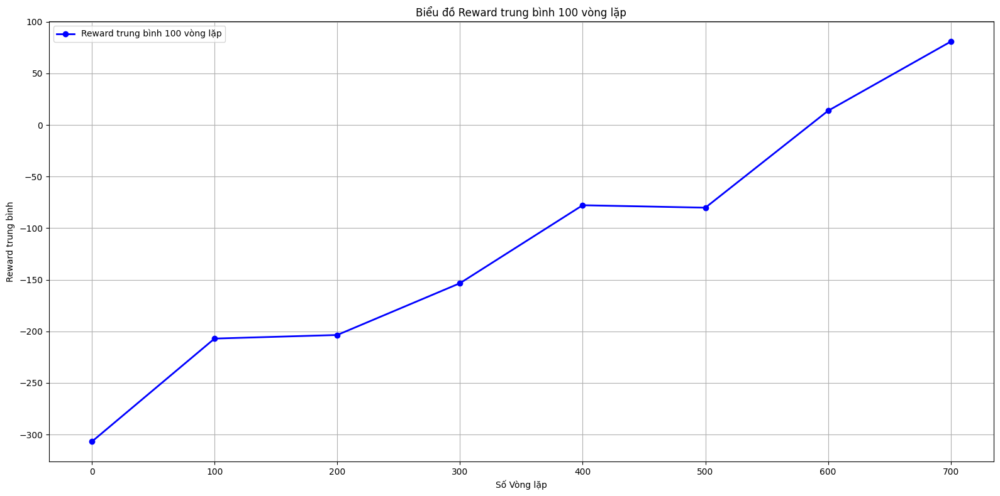

In [40]:
avg_rewards = [
    sum(list_reward[i: i + 100]) / len(list_reward[i: i + 100])
    for i in range(0, len(list_reward), 100)
]

plt.figure(figsize=(16, 8))
plt.plot(
    range(0, len(list_reward), 100),
    avg_rewards,
    label="Reward trung bình 100 vòng lặp",
    marker='o',
    color='#0000FF',
    linewidth=2
)
plt.xlabel("Số Vòng lặp")
plt.ylabel("Reward trung bình")
plt.title("Biểu đồ Reward trung bình 100 vòng lặp")
plt.legend(loc='upper left')
plt.grid(True)
plt.tight_layout()
plt.legend()
plt.show()

Đồ thị mô tả điểm trung bình mà agent nhận được trên 100 tập huấn luyện, ta thấy ở tập 600 agent đã bắt đầu khôn hơn trước, nếu như tăng cường huấn luyện thêm thì agent sẽ học hỏi thêm được cách hạ cánh tối ưu (khôn hơn) rất nhiều và đạt hiệu suất tỉ lệ hạ cánh thành công cao hơn. 

In [ ]:
# Load môi trường và model :
environment = gym.make("LunarLander-v3", render_mode="rgb_array")

policy_net.to(device)  # Đưa mô hình lên đúng thiết bị
policy_net.load_state_dict(torch.load(
    "best_model_adamw_smoothl1.pth", map_location=device))

policy_net.eval()

# Số liệu kiểm tra tỉ lệ hạ cánh thành công của agent :
# Điểm thưởng tối thiểu agent nhận được để hạ cánh thành công :
reward_success = 200
count = 0  # Đếm số lần điểm thưởng > 200
rewards = []  # Danh sách lưu điểm thưởng

for i in trange(1000):
    state, _ = environment.reset()
    done = False
    total_reward = 0

    while not done:
        with torch.no_grad():
            state_tensor = torch.FloatTensor(state).unsqueeze(0).to(device)
            action = policy_net(state_tensor).argmax().item()

        next_state, reward, done, truncated, _ = environment.step(action)
        state = next_state
        total_reward += reward
        if truncated:
            break

    rewards.append(total_reward)
    if total_reward >= reward_success:
        count += 1

environment.close()

# Tính toán tỷ lệ hạ cánh thành công của tàu vũ trụ :
success_rate = count / 1000 * 100
print(f"Tỷ lệ thành công: {success_rate:.2f}%")


C:\Users\NGUYEN GIA KHANH\AppData\Local\Temp\ipykernel_26860\1946360138.py:5: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  policy_net.load_state_dict(torch.load(
100%|█████

Tỷ lệ thành công: 86.60%


In [41]:
# Load môi trường và mô hình
environment = gym.make("LunarLander-v3", render_mode="rgb_array")

policy_net.load_state_dict(torch.load(
    "best_model_adamw_smoothl1.pth", map_location=device))
policy_net.to(device)
policy_net.eval()

state, _ = environment.reset()
done = False
total_reward = 0
frames = []

while not done:
    state_tensor = torch.FloatTensor(state).unsqueeze(0).to(device)
    with torch.no_grad():
        action = policy_net(state_tensor).argmax().item()
    next_state, reward, terminated, truncated, _ = environment.step(action)
    done = terminated or truncated
    frames.append(environment.render())
    state = next_state
    total_reward += reward

environment.close()

# Tạo animation hiển thị trong notebook
fig, ax = plt.subplots()
fig.set_size_inches(6.4, 4.8)
ax.axis('off')
img = ax.imshow(frames[0])


def update(frame):
    img.set_array(frame)
    return [img]


ani = animation.FuncAnimation(
    fig, update, frames=frames, interval=33, blit=True)
plt.close(fig)  # Không hiển thị ảnh tĩnh

print(f"Tổng điểm thưởng mà agent nhận được là: {total_reward:.2f}")

HTML(ani.to_jshtml())

C:\Users\NGUYEN GIA KHANH\AppData\Local\Temp\ipykernel_7348\1350461863.py:4: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  policy_net.load_state_dict(torch.load(


Tổng điểm thưởng mà agent nhận được là: 259.86


Nhận xét : Khi thay đổi learning_rate bằng cách giảm đi so với ban đầu và tăng chỉ số discount factor kết hợp với việc sử dụng thuật toán tối ưu Adamw và hàm loss (SmoothL1Loss()) thấy được tỷ lệ hạ cánh thành công của tàu vũ trụ so với ban đầu bị giảm đi đáng kể ( từ 95.6% xuống còn 86.6%). Điều này được giải thích là khi chúng ta giảm learning rate khiến quá trình cập nhật trọng số trở nên chậm hơn, từ đó giảm tốc độ hội tụ (thời gian huấn luyện lâu hơn), tăng discount factor khiến mô hình ưu tiên phần thưởng dài hạn hơn khiến cho mô hình ít chính xác hơn nếu chưa có đủ kinh nghiệm để học. Hàm mất mát SmoothL1Loss ít nhạy cảm với sai số nhỏ so với MSELoss, dẫn đến việc mô hình không phản ứng đủ mạnh với các sai lệch. Tóm lại sau khi điều chỉnh ta thấy tỉ lệ hạ cánh thành công của agent giảm hơn so với ban đầu. 

## 2, Thuật toán tiếp theo sử dụng để giải quyết bài toán : Double - DQN 

- Lý thuyết: Double DQN (Double Deep Q-Network) là một cải tiến của DQN nhằm khắc phục vấn đề đánh giá quá cao (overestimation bias) của hàm Q khi sử dụng hàm $\max$ trong DQN. Thuật toán này được đề xuất bởi Hado van Hasselt (2015), và vẫn giữ nguyên khung hoạt động cơ bản của DQN như replay buffer và target network, nhưng thay đổi cách tính giá trị mục tiêu Q để quá trình học ổn định và trở nên chính xác hơn.

- Mô hình toán học của thuật toán : Tại mỗi thời điểm $t$, agent thực hiện: 

  1. Quan sát trạng thái: $s_t \in S$
  2. Chọn hành động: $a_t \in A$
  3. Nhận phần thưởng: $r_t$
  4. Chuyển sang trạng thái tiếp theo: $s_{t+1}$
  5. Chính sách tối ưu: $\pi(a \mid s)$

- Hàm giá trị hành động tối ưu được xấp xỉ bằng mạng neural: $ Q(s, a; \theta) \approx Q^*(s, a) $

- Điểm khác biệt của Double DQN nằm ở cách tính giá trị mục tiêu $y$ trong hàm mất mát:

  - Trong DQN:$ y = r + \gamma \max_{a'} Q(s', a'; \theta^-) $

  - Trong Double DQN: $ a^* = \arg\max_{a'} Q(s', a'; \theta) \\ y = r + \gamma Q(s', a^*; \theta^-)$

  => Mạng chính ($\theta$) chọn hành động tốt nhất, còn mạng target ($\theta^-$) đánh giá hành động đó điều này giúp giảm thiên lệch tối ưu hóa quá mức.

- Hàm mất mát: $ L(\theta) = \mathbb{E}_{(s,a,r,s') \sim D} \left[ \left( y - Q(s,a;\theta) \right)^2 \right] $

- Cách thuật toán Double DQN hoạt động:

  - Khởi tạo mạng Q chính: $Q(s, a; \theta)$  
  - Khởi tạo target network: $Q(s, a; \theta^-) = Q(s, a; \theta)$  
  - Khởi tạo replay buffer $D$  

- Lặp lại cho mỗi episode:

1. Reset môi trường
2. Với mỗi bước trong episode:
   - Chọn hành động $a$ theo chiến lược $\varepsilon$-greedy từ $Q(s, a; \theta)$
   - Thực hiện hành động $a$, nhận $r$
   - Lưu $(s, a, r, s')$ vào replay buffer $D$
   - Lấy minibatch từ $D$
   - Với mỗi mẫu $(s, a, r, s')$:
     - Tính: $ a^* = \arg\max_{a'} Q(s', a'; \theta) $
     - Tính giá trị mục tiêu : $ y = r + \gamma Q(s', a^*; \theta^-) $
   - Cập nhật $\theta$ bằng cách tối thiểu hóa:
     $ \left( y - Q(s,a;\theta) \right)^2 $

3. Cập nhật target network định kỳ: $\theta^- \leftarrow \theta$

- Nhận xét:

  - Môi trường LunarLander-v3 có không gian trạng thái liên tục và hành động rời rạc, phù hợp với DQN. Tuy nhiên, DQN thường đánh giá quá cao giá trị hành động  nên hiệu quả học không ổn định.

  - Double DQN khắc phục điều này bằng cách tách bước chọn và đánh giá hành động điều này giúp giảm thiên lệch, tăng tính ổn định và giúp mô hình học chính sách hiệu quả hơn. Nhờ đó, tàu vũ trụ có thể hạ cánh thành công. 


#### Khai báo thư viện cần dùng :

In [15]:
import gymnasium as gym
import torch
import torch.nn as nn
import torch.optim as optim
import random
from collections import deque
import matplotlib.pyplot as plt
from tqdm import trange
import matplotlib.animation as animation
from IPython.display import HTML

#### Thiết bị dùng để tính toán : 

In [16]:
if torch.cuda.is_available():
    device = torch.device("cuda")
    device_name = torch.cuda.get_device_name(device)
    print(f"Thiết bị sử dụng để tính toán là : {device_name}")
else:
    print(f"Sử dụng CPU để tính toán")

Thiết bị sử dụng để tính toán là : NVIDIA GeForce RTX 3050 Laptop GPU


#### Khởi tạo các siêu tham số : 

In [17]:
episodes = 3000  # Số tập huấn luyện của agent.
max_steps = 1000  # Số bước của agent trong quá trình thực hiện.
batch_size = 64  # Số mẫu lấy ra từ replay buffer mỗi lần huấn luyện.
gamma = 0.99  # Hệ số chiết khấu.
learning_rate = 0.001  # Tốc độ học của mạng.
epsilon_start = 1.0  # Xác suất chọn hành động ngẫu nhiên của agent.
epsilon_end = 0.01  # Giá trị tối thiểu của epsilon.
epsilon_decay = 0.997  # Tốc độ giảm epsilon sau mỗi tập.
# Sau mỗi 10 tập huấn luyện, các trọng số của target network sẽ được cập nhật bằng trọng số mới nhất của Q-network.
target_update = 10
memory_size = 100000  # Kích thước tối đa của replay buffer.
model_save_path = "./best_double_dqn_main.pth"  # Đường dẫn lưu model tốt nhất.

#### Khởi tạo môi trường : 

In [18]:
environment = gym.make("LunarLander-v3", render_mode="rgb_array")
state_size = environment.observation_space.shape[0]
action_size = environment.action_space.n

#### Class Double_DQN : 

- Class Double_DQN là một mạng neural dùng trong học tăng cường để ước lượng Q-value cho từng hành động, từ một trạng thái đầu vào. Nó gồm 3 lớp Linear với ReLU, đầu ra là vector Q-values cho tất cả các hành động.  

- Hàm forward(x) nhận đầu vào là một trạng thái là 1 vector có kích thước state_size, biểu diễn thông tin hiện tại của môi trường và trả về một vector có độ dài bằng action_size, đại diện cho các giá trị Q-value của từng hành động của agent thực hiện trong môi trường. 

In [19]:
class Double_DQN(nn.Module):
    def __init__(self, state_size, action_size):
        super(Double_DQN, self).__init__()
        self.net = nn.Sequential(
            nn.Linear(state_size, 256),
            nn.ReLU(),
            nn.Linear(256, 256),
            nn.ReLU(),
            nn.Linear(256, action_size),
        )

    def forward(self, x):
        return self.net(x)

#### Replay Buffer :   
 - deque: là một hàng đợi hai đầu , cho phép thêm/xóa phần tử ở hai đầu.  
 - maxlen=memory_size: giới hạn kích thước bộ nhớ. Khi đầy, phần tử cũ nhất sẽ tự động bị loại bỏ để nhường chỗ cho phần mới.

In [20]:
memory = deque(maxlen=memory_size)

#### Khởi tạo mạng :  
   - online_net : Là mạng chính chọn hành động, dùng để huấn luyện mạng này được cập nhật liên tục theo gradient descent. 
   - target_net : Là mạng dùng để tính Q-value mục tiêu, được cập nhật theo target_update bằng cách sao chép từ online_net


In [21]:
online_net = Double_DQN(state_size, action_size).to(device)
target_net = Double_DQN(state_size, action_size).to(device)
target_net.load_state_dict(online_net.state_dict())

<All keys matched successfully>

#### Chiến lược epsilon-greedy :  
- Với xác suất epsilon, chọn hành động ngẫu nhiên. 
- Với xác suất 1 - epsilon, chọn hành động có giá trị Q cao nhất theo mạng online_net.  

Hàm choose_action (state, epsilon) có mục đích chọn hành động trong môi trường Reinforcement Learning tuân theo chiến lược epsilon-greedy, state là trạng thái hiện tại của môi  trường, epsilon là tham số xác suất để chọn hành động ngẫu nhiên.  


In [22]:
def choose_action(state, epsilon):
    if random.random() < epsilon:
        # Tạo ra 1 số ngẫu nhiên nhỏ hơn epsilon => chọn hành động ngẫu nhiên
        return random.randint(0, action_size-1)
    state_tensor = torch.FloatTensor(state).unsqueeze(0).to(device)
    with torch.no_grad():
        Q_values = online_net(state_tensor)  # Dự đoán Q-values từ online_net.
    # Return hành động có giá trị Q-values lớn nhất.
    return Q_values.argmax().item()

In [23]:
# Tối ưu trọng số của mạng online_net.
optimizer = optim.Adam(online_net.parameters(), lr=learning_rate)
# Tính toán sai số giữa giá trị mạng dự đoán và giá trị mục tiêu.
criterion = nn.MSELoss()

#### Hàm replay () :  

- Mục đích : Giúp agent học chính sách hành động tối ưu từ kinh nghiệm cũ, đảm bảo học ổn định và hiệu quả hơn DQN chuẩn. 
- Lấy mẫu ngẫu nhiên (minibatch) từ bộ nhớ kinh nghiệm (memory) 
- Tính toán Q-value mục tiêu bằng cách sử dụng Double DQN: chọn hành động bằng online_net, đánh giá bằng target_net => giúp giảm overestimation bias. 
- Tính loss giữa Q-value dự đoán và mục tiêu, sau đó cập nhật trọng số mạng online thông qua lan truyền ngược.



In [24]:
def replay():
    #  Nếu số lượng mẫu trong bộ nhớ chưa đủ để tạo một batch, bỏ qua quá trình huấn luyện.
    if len(memory) < batch_size:
        return
    # # Lấy ngẫu nhiên một nhóm trải nghiệm từ bộ nhớ, rồi tách riêng từng phần :
    batch = random.sample(memory, batch_size)
    states, actions, rewards, next_states, dones = zip(*batch)

    # Chuyển dữ liệu sang tensor và đưa lên thiết bị GPU phục vụ tính toán :
    states = torch.FloatTensor(states).to(device)
    actions = torch.LongTensor(actions).unsqueeze(1).to(device)
    rewards = torch.FloatTensor(rewards).unsqueeze(1).to(device)
    next_states = torch.FloatTensor(next_states).to(device)
    dones = torch.FloatTensor(dones).unsqueeze(1).to(device)

    # Tính toán Q-values cho từng hành động tại mỗi next_state, sau đó chọn hành động có giá trị Q-value cao nhất.
    next_actions = online_net(next_states).argmax(1, keepdim=True)
    # Tính tất cả các giá trị Q-value cho next_states, lấy Q-value tương ứng với action được chọn bởi online_net.
    next_Q_value = target_net(next_states).gather(1, next_actions)
    # Tính giá trị Q-value mục tiêu.
    targets = rewards + gamma * next_Q_value * (1 - dones)
    # dự đoán Q-value cho các state hiện tại, lấy ra Q-value của hành động thực tế mà agent đã chọn ở các state đó.
    Q_current = online_net(states).gather(1, actions)

    # Đây chính là điểm khác biệt của Double_DQN so với DQN : DQN – chọn và đánh giá hành động tốt nhất bằng cùng một mạng target_net điều này dẫn đến hiện tượng dễ overestimate Q-value. Còn Double_DQN : tách riêng chọn và đánh giá hành động ( mạng online_net sẽ chọn hành động tốt nhất cho agent sau đó mạng target_net để đánh giá hành động đó) đảm bảo giá trị Q-value được đánh giá ổn định hơn, giảm được hiện tượng overestimation bias của DQN dẫn đến tỉ lệ hạ cánh thành công cao hơn, hiệu suất sử dụng nhiên liệu của agent trong môi trường tốt hơn so với DQN.

    # Tính toán sai số giữa Q-value mạng dự đoán và giá trị mục tiêu.
    loss = criterion(Q_current, targets.detach())

    # # Tính gradient descent và cập nhật trọng số của mạng để giảm loss.
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()

#### Hàm huấn luyện chính :  
Mục đích huấn luyện agent có thể hạ cánh thành công với tỉ lệ thành công cao nhất, tiết kiếm được nhiều nhiên liệu qua nhiều lần chơi khác nhau . 

- Tương tác với môi trường qua nhiều vòng lặp . 

- Lưu lại trải nghiệm vào bộ nhớ . 

- Học từ trải nghiệm bằng hàm replay() . 

- Cập nhật dần epsilon để giúp cho agent giảm dần tính ngẫu nhiên, giúp cho agent trở nên thông mình hơn tìm được hành động tốt hơn. 

- Cập nhật mạng mục tiêu định kỳ theo target_update .  
  
- Lưu lại model tốt nhất . 

In [ ]:
epsilon = epsilon_start
best_reward = -float("inf")
list_reward = []

for i in range(1, episodes + 1):
    state, _ = environment.reset()
    total_reward = 0

    for step in range(max_steps):
        # Chọn hành động theo epsilon-greedy
        action = choose_action(state, epsilon)
        next_state, reward, terminated, truncated, _ = environment.step(action)
        done = terminated or truncated

        # Reward shaping: phạt nếu lệch khỏi trung tâm
        reward += -10 * abs(state[0])

        # Lưu vào bộ nhớ
        memory.append((state, action, reward, next_state, done))
        state = next_state
        total_reward += reward

        # Huấn luyện từ replay buffer
        replay()  
       
        if done:
            break

    # Cập nhật epsilon
    epsilon = max(epsilon_end, epsilon * epsilon_decay)

    # Ghi lại phần thưởng của tập hiện tại
    list_reward.append(total_reward)
    
    # Cập nhật target network định kỳ
    if i % target_update == 0:
        target_net.load_state_dict(online_net.state_dict())

    # Lưu model nếu đạt điểm cao hơn trước
    if total_reward > best_reward:
        best_reward = total_reward
        torch.save(online_net.state_dict(), model_save_path)


environment.close()

In [29]:
print(max(list_reward))

285.5562667414415


#### Đồ thị hàm điểm thưởng của agent trên trung bình 100 tập huấn luyện : 

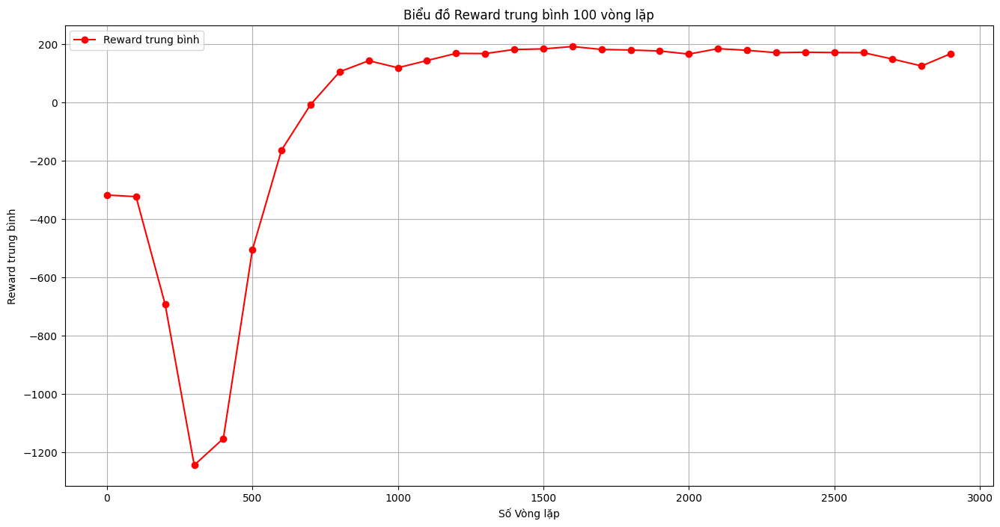

In [70]:
avg_rewards = [sum(list_reward[i : i + 100]) / 100 for i in range(0, len(list_reward), 100)]

plt.figure(figsize=(16, 8))
plt.plot(range(0, len(list_reward), 100), avg_rewards, marker='o', color='#FF0000') 
plt.xlabel("Số Vòng lặp")
plt.ylabel("Reward trung bình")
plt.title("Biểu đồ Reward trung bình 100 vòng lặp")
plt.legend(["Reward trung bình"], loc='upper left')  # Đặt nhãn cho legend
plt.grid(True)
plt.show()

Biểu đồ thể hiện chi tiết điểm thưởng trung bình trên 100 tập huấn luyện mà agent nhận được. Kết quả cho thấy từ tập huấn luyện 700 trở đi thì điểm thưởng trung bình của agent tăng nhiều tức là lúc này agent chuyển từ hành động khám phá môi trường sang hành động khia thác môi trường để nó biết cách thích ứng với điều kiện môi trường, học được cách hạ cánh an toàn và tối ưu nhất. 

#### Hàm tạo video sau khi huấn luyện agent xong : 

In [48]:
# Load môi trường và mô hình
environment = gym.make("LunarLander-v3", render_mode="rgb_array")

online_net.load_state_dict(torch.load(
    "best_double_dqn_main.pth", map_location=device))
online_net.to(device)
online_net.eval()

state, _ = environment.reset()
done = False
total_reward = 0
frames = []

while not done:
    state_tensor = torch.FloatTensor(state).unsqueeze(0).to(device)
    with torch.no_grad():
        action = online_net(state_tensor).argmax().item()
    next_state, reward, terminated, truncated, _ = environment.step(action)
    done = terminated or truncated
    frames.append(environment.render())
    state = next_state
    total_reward += reward

environment.close()

# Tạo animation hiển thị trong notebook
fig, ax = plt.subplots()
fig.set_size_inches(6.4, 4.8)
ax.axis('off')
img = ax.imshow(frames[0])


def update(frame):
    img.set_array(frame)
    return [img]


ani = animation.FuncAnimation(
    fig, update, frames=frames, interval=33, blit=True)
plt.close(fig)  # Không hiển thị ảnh tĩnh

print(f"Tổng điểm thưởng mà agent nhận được là: {total_reward:.2f}")

HTML(ani.to_jshtml())

C:\Users\NGUYEN GIA KHANH\AppData\Local\Temp\ipykernel_7348\3127960960.py:4: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  online_net.load_state_dict(torch.load(


Tổng điểm thưởng mà agent nhận được là: 243.33


#### Hàm đánh giá tỷ lệ hạ cánh thành công của agent : 

In [ ]:
# Load môi trường và mô hình
environment = gym.make("LunarLander-v3", render_mode="rgb_array")

online_net.load_state_dict(torch.load("best_double_dqn_main.pth", map_location=device))
online_net.to(device)
online_net.eval()

# Số liệu kiểm tra tỉ lệ hạ cánh thành công của agent :
reward_success = 200 # Điểm thưởng tối thiểu agent nhận được để hạ cánh thành công : 
count = 0 # Biến đếm số lần điểm thưởng > 200 
rewards = [] # Danh sách lưu điểm thưởng 

for i in trange(1000):
    state, _ = environment.reset()
    done = False
    total_reward = 0

    while not done:
        with torch.no_grad():
            state_tensor = torch.FloatTensor(state).unsqueeze(0).to(device)
            action = online_net(state_tensor).argmax().item()

        next_state, reward, done, truncated, _ = environment.step(action)
        state = next_state
        total_reward += reward
        if truncated:
            break

    rewards.append(total_reward)
    if total_reward >= reward_success:
        count += 1

environment.close()

# Tính toán tỷ lệ hạ cánh thành công của tàu vũ trụ :
success_rate = count / 1000 * 100
print(f"Tỷ lệ thành công: {success_rate:.2f}%")

C:\Users\NGUYEN GIA KHANH\AppData\Local\Temp\ipykernel_19900\3703277354.py:4: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  online_net.load_state_dict(torch.load("best_doubl

100%|██████████| 1000/1000 [09:42<00:00,  1.72it/s]

Tỷ lệ thành công: 99.70%


Để đảm bảo model hoạt động tốt đạt chất lượng tốt và đạt độ tin cậy cao em đã thực nghiệm lại nó trên 1000 tập huấn luyện để biết được độ chính xác của model.Với ngưỡng điểm thưởng tối thiểu được thiết lập là 200 thì tỉ lệ hạ cánh thành công của tàu vũ trụ khi sử dụng thuật toán Double-DQN lên tới 99.7% cho thấy được hiệu quả của model. Với tỉ lệ thành công đạt rất cao cho thấy agent học được cách đi tối ưu để hạ cánh an toàn một cách hiệu quả.  

#### Hàm đánh giá hiệu suất động cơ, hiệu suất sử dụng nhiêu liệu của agent : 

In [ ]:
from collections import Counter

env = gym.make("LunarLander-v3")
state_size = env.observation_space.shape[0]
action_size = env.action_space.n

online_net = Double_DQN(state_size, action_size)
online_net.load_state_dict(torch.load("best_double_dqn_main.pth"))
online_net.eval()

n_episodes = 100
engine_usage = Counter()
rewards = []

for _ in range(n_episodes):
    state, _ = env.reset()
    done = False
    total_reward = 0

    while not done:
        with torch.no_grad():
            state_tensor = torch.FloatTensor(state).unsqueeze(0)
            action = online_net(state_tensor).argmax().item()

        engine_usage[action] += 1  # Ghi nhận hành động
        next_state, reward, done, truncated, _ = env.step(action)
        state = next_state
        total_reward += reward
        if truncated:
            break

    rewards.append(total_reward)

env.close()

# Tính toán hiệu suất sử dụng nhiên liệu
total_actions = sum(engine_usage.values())
no_engine_pct = engine_usage[0] / total_actions * 100
main_engine_pct = engine_usage[1] / total_actions * 100
side_engine_pct = (engine_usage[2] + engine_usage[3]) / total_actions * 100

print("Hiệu suất sử dụng nhiên liệu của agent : ")
print(f"Số hành động mà agent đã sử dụng: {total_actions}")
print(f"Tỷ lệ agent không sử dụng động cơ (%): {engine_usage[0]} ({no_engine_pct:.2f}%)")
print(f"Tỷ lệ agent dùng động cơ chính (%): {engine_usage[1]} ({main_engine_pct:.2f}%)")
print(f"Tỷ lệ agent dùng động cơ phụ (%): {engine_usage[2] + engine_usage[3]} ({side_engine_pct:.2f}%)") 


C:\Users\NGUYEN GIA KHANH\AppData\Local\Temp\ipykernel_26968\236064278.py:8: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  online_net.load_state_dict(torch.load("best_double

Hiệu suất sử dụng nhiên liệu của agent : 
Số hành động mà agent đã sử dụng: 21932
Tỷ lệ agent không sử dụng động cơ (%): 4872 (22.21%)
Tỷ lệ agent dùng động cơ chính (%): 3363 (15.33%)
Tỷ lệ agent dùng động cơ phụ (%): 13697 (62.45%)


Nhận xét : Dựa vào kết quả ở trên ta thấy agent đã sử dụng tổng cộng 21932 hành động, trong đó tỷ lệ agent không sử dụng động cơ khoảng hơn 22%, điều này chứng tỏ agent đã tận dụng được quán tính và trọng lực để di chuyển mà không tiêu tốn quá nhiều nhiên liệu. Tỷ lệ agent sử dụng động cơ chính là 15.33% trong tổng số hành động cho thấy agent đã hạn chế sử dụng lực đẩy mạnh, agent biết kích hoạt động cơ chính khi thực sự cần thiết, chẳng hạn như trong các giai đoạn hạ cánh để giảm tốc độ rơi hoặc tránh va chạm mạnh agent đã học được chính sách điều khiển hiệu quả an toàn những tiết kiệm biết cách sử dụng lực đẩy mạnh một cách chiến lược thay vì lạm dụng nó. Tỷ lệ 62.45% sử dụng động cơ phụ cho thấy agent đã học được cách điều khiển sao cho hợp lý, ưu tiên điều chỉnh vị trí và tư thế thay vì chỉ tập trung vào lực đẩy thẳng. Như vậy ta thấy sau 3000 tập huấn luyện agent đã biết cách hạ cánh với tỷ lệ thành công rất cao là 99.7%. 

#### Chỉnh hệ số discount_actor, learning_rate so với ban đầu : 

In [ ]:
episodes = 1000
max_steps = 1000
batch_size = 64
gamma = 0.999 # Tăng gamma
learning_rate = 1e-4 # Giảm learning_rate
epsilon_start = 1.0
epsilon_end = 0.01
epsilon_decay = 0.997
target_update = 10
memory_size = 100000
model_save_path = "./best_double_dqn_8.pth"

In [ ]:
optimizer = optim.AdamW(online_net.parameters(), lr=learning_rate)  # Thay đổi optim
criterion = nn.MSELoss()  # Giữ nguyên hàm mất mát. 

In [22]:
def replay():
    if len(memory) < batch_size:
        return
    batch = random.sample(memory, batch_size)
    states, actions, rewards, next_states, dones = zip(*batch)

    # Chuyển dữ liệu sang tensor và đưa lên thiết bị GPU phục vụ tính toán :
    states = torch.FloatTensor(states).to(device)
    actions = torch.LongTensor(actions).unsqueeze(1).to(device)
    rewards = torch.FloatTensor(rewards).unsqueeze(1).to(device)
    next_states = torch.FloatTensor(next_states).to(device)
    dones = torch.FloatTensor(dones).unsqueeze(1).to(device)

    next_actions = online_net(next_states).argmax(1, keepdim=True)
    next_Q_value = target_net(next_states).gather(1, next_actions)
    targets = rewards + gamma * next_Q_value * (1 - dones)
    Q_current = online_net(states).gather(1, actions)

    loss = criterion(Q_current, targets.detach())
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()

In [ ]:
epsilon = epsilon_start
best_reward = -float("inf")
list_reward = []

for i in range(1, episodes + 1):
    state, _ = environment.reset()
    total_reward = 0

    for step in range(max_steps):
        # Chọn hành động theo epsilon-greedy
        action = choose_action(state, epsilon)
        next_state, reward, terminated, truncated, _ = environment.step(action)
        done = terminated or truncated

        # Reward shaping: phạt nếu lệch khỏi trung tâm
        reward += -10 * abs(state[0])

        # Lưu vào bộ nhớ
        memory.append((state, action, reward, next_state, done))
        state = next_state
        total_reward += reward

        # Huấn luyện từ replay buffer
        replay()

        if done:
            break

    # Cập nhật epsilon
    epsilon = max(epsilon_end, epsilon * epsilon_decay)

    # Ghi lại phần thưởng của tập hiện tại
    list_reward.append(total_reward)

    # Cập nhật target network định kỳ
    if i % target_update == 0:
        target_net.load_state_dict(online_net.state_dict())

    # Lưu model nếu đạt điểm cao hơn trước
    if total_reward > best_reward:
        best_reward = total_reward
        torch.save(online_net.state_dict(), model_save_path)

environment.close()

In [24]:
print(max(list_reward))

224.80052558295898


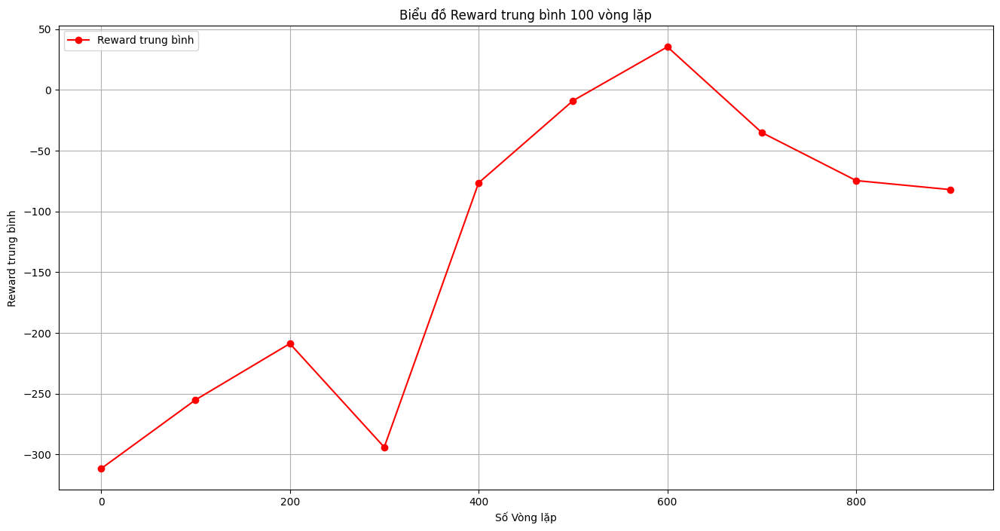

In [25]:
avg_rewards = [sum(list_reward[i: i + 100]) /
               100 for i in range(0, len(list_reward), 100)]

plt.figure(figsize=(16, 8))
plt.plot(range(0, len(list_reward), 100),
         avg_rewards, marker='o', color='#FF0000')
plt.xlabel("Số Vòng lặp")
plt.ylabel("Reward trung bình")
plt.title("Biểu đồ Reward trung bình 100 vòng lặp")
plt.legend(["Reward trung bình"], loc='upper left')  # Đặt nhãn cho legend
plt.grid(True)
plt.show()

Nhận xét : Biểu đồ điểm thưởng trung bình của agent nhận được sau khi tiến hành huấn luyện 1000 lần, thấy được sự khác biệt và sự thay đổi rất lớn sau khi điểu chỉnh lại hệ số learning_rate và gamma, thay đổi optim. Điểm thưởng trung bình mà agent nhận được qua các tập train giảm rất mạnh so với ban đầu tuy nhiên điểm thưởng mà agent đạt được cao nhất trong quá trình train là 224.8 vẫn đảm bảo cho agent hạ cách an toàn mà hai chân không bị vỡ mặc dù vậy những tỉ lệ hạ cánh thành công giảm đi đáng kể so với mô hình ban đầu. Như vậy ta thấy việc thay đổi hệ số learning_rate, gamma, optim đóng vai trò rất quan trọng trong việc tối ưu tỷ lệ hạ cánh thành công của agent đạt được cao nhất. 

In [ ]:
# Load môi trường và mô hình
environment = gym.make("LunarLander-v3", render_mode="rgb_array")

online_net.load_state_dict(torch.load("best_double_dqn_8.pth", map_location=device))
online_net.to(device)
online_net.eval()

state, _ = environment.reset()
done = False
total_reward = 0
frames = []

while not done:
    state_tensor = torch.FloatTensor(state).unsqueeze(0).to(device)
    with torch.no_grad():
        action = online_net(state_tensor).argmax().item()
    next_state, reward, terminated, truncated, _ = environment.step(action)
    done = terminated or truncated
    frames.append(environment.render())
    state = next_state
    total_reward += reward

environment.close()

# Tạo animation hiển thị trong notebook
fig, ax = plt.subplots()
fig.set_size_inches(6.4, 4.8)
ax.axis('off')
img = ax.imshow(frames[0])


def update(frame):
    img.set_array(frame)
    return [img]


ani = animation.FuncAnimation(
    fig, update, frames=frames, interval=33, blit=True)
plt.close(fig)  # Không hiển thị ảnh tĩnh

HTML(ani.to_jshtml())

C:\Users\NGUYEN GIA KHANH\AppData\Local\Temp\ipykernel_26968\2612337962.py:4: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  online_net.load_state_dict(torch.load(


In [ ]:
# Load môi trường và mô hình
environment = gym.make("LunarLander-v3", render_mode="rgb_array")

online_net.load_state_dict(torch.load("best_double_dqn_8.pth", map_location=device))
online_net.to(device)
online_net.eval()

# Số liệu kiểm tra tỉ lệ hạ cánh thành công của agent :
# Điểm thưởng tối thiểu agent nhận được để hạ cánh thành công :
reward_success = 200
count = 0  # Đếm số lần điểm thưởng > 200
rewards = []  # Danh sách lưu điểm thưởng

for i in trange(1000):
    state, _ = environment.reset()
    done = False
    total_reward = 0

    while not done:
        with torch.no_grad():
            state_tensor = torch.FloatTensor(state).unsqueeze(0).to(device)
            action = online_net(state_tensor).argmax().item()

        next_state, reward, done, truncated, _ = environment.step(action)
        state = next_state
        total_reward += reward
        if truncated:
            break

    rewards.append(total_reward)
    if total_reward >= reward_success:
        count += 1

environment.close()

# Tính toán tỷ lệ hạ cánh thành công của tàu vũ trụ :
success_rate = count / 1000 * 100
print(f"Tỷ lệ thành công: {success_rate:.2f}%")
print(max(list_reward))

C:\Users\NGUYEN GIA KHANH\AppData\Local\Temp\ipykernel_26968\4138779172.py:4: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  online_net.load_state_dict(torch.load(
100%|█████

Tỷ lệ thành công: 39.20%
224.80052558295898


Tỉ lệ hạ cánh thành công của agent chỉ đạt mức 39.2% thấp hơn rất nhiều so với tỷ lệ thành công ở mô hình trước. Với việc giảm learning_rate và tăng hệ số chiết khấu, thay đổi tối ưu hóa và giữ nguyên hàm loss đã ảnh hưởng không nhỏ tới tỉ lệ hạ cánh thành công của tàu vũ trụ. Cụ thể khi chúng ta giảm learning_rate khiến quá trình cập nhật trọng số trở nên chậm hơn dẫn tới việc thời gian huấn luyện agent lâu hơn, nếu tăng hệ số chiết khấu quá mức khiến cho mô hình ưu tiên phần thưởng dài hạn hơn dẫn tới việc học được ít kinh nghiệm hơn dẫn tới kết quả không chính xác. Tóm lại việc thay đổi như vậy, ảnh hưởng rất lớn với tỷ lệ hạ cánh thành công của agent. 

### Kết luận : 

Trong quá trình nghiên cứu và triển khai bài toán **LunarLander-v3**, em đã áp dụng thành công hai thuật toán học tăng cường sâu phổ biến là **Deep Q-Network (DQN)** và **Double Deep Q-Network (Double DQN)**. Mục tiêu chính là huấn luyện một agent có khả năng điều khiển tàu vũ trụ hạ cánh an toàn vào vùng mục tiêu nằm giữa hai cột cờ, trong điều kiện môi trường có không gian trạng thái liên tục (8 chiều) và không gian hành động rời rạc (4 hành động).

#### 1. Kết quả thực nghiệm

Kết quả thực nghiệm cho thấy sự khác biệt rõ ràng về hiệu quả học giữa hai thuật toán:

- Thuật toán **DQN** đạt **tỷ lệ hạ cánh thành công trung bình 95.6%** sau quá trình huấn luyện. Mô hình thể hiện khả năng học chính sách tương đối tốt, tuy nhiên vẫn gặp phải hiện tượng **overestimation** – tức là đánh giá quá cao giá trị kỳ vọng (Q-value) của một số hành động, dẫn đến việc agent đôi khi chọn lựa hành vi chưa tối ưu. 

- Thuật toán **Double DQN**, với cơ chế tách biệt giữa hành động được chọn (qua mạng chính) và hành động được đánh giá (qua mạng mục tiêu), giúp khắc phục nhược điểm nói trên. Kết quả cho thấy **tỷ lệ hạ cánh thành công đạt 99.7%** - tỷ lệ hạ cánh thành công rất cao của agent. Điều này cho thấy chính sách học được có độ ổn định và chính xác cao hơn. 

Những khác biệt này khẳng định rằng **Double DQN là một cải tiến đáng kể và có ý nghĩa thực tiễn cao trong việc huấn luyện agent thông minh  và việc đánh giá chính xác hành động là yếu tố cực kì quan trọng quyết định việc hạ cánh thành công của agent.**

#### 2. Phân tích và nhận định

Một trong những thách thức chính của môi trường LunarLander-v3 là sự **phi tuyến tính và tính ngẫu nhiên cao** trong trạng thái khởi đầu, tác động môi trường và phản hồi từ hệ thống động cơ. Trong bối cảnh đó, việc sử dụng thuật toán DQN đôi khi dẫn đến quá trình học bị lệch hướng do các **ước lượng Q-value bị phóng đại**, gây ra chính sách không ổn định ở các giai đoạn huấn luyện đầu hoặc khi gặp tình huống mới lạ. Double DQN, nhờ cơ chế tách biệt nói trên, đã **giảm thiểu sai lệch trong ước lượng giá trị hành động**, từ đó cải thiện đáng kể chất lượng chính sách học được và độ bền vững khi triển khai.

#### 3. Hướng phát triển tương lai
Trong tương lai, em sẽ tiếp tục nghiên cứu và áp dụng các thuật toán nâng cao hơn như Dueling DQN, Prioritized Experience Replay, Actor-Critic để nâng cao khả năng ra quyết định, tăng tốc độ hội tụ và khả năng tổng quát hóa chính sách để giúp cho tỷ lệ hạ cánh thành công của tàu vũ trụ đạt độ chính xác cao nhất .
